# US Fast Food Restaurants
This notebook analyses the distance between US fast food restaurant, available at https://www.kaggle.com/datafiniti/fast-food-restaurants.


# Table of Contents

1. [Data Visualisation](#data-vis)
    <br>1.1 [US Map](#US-map)
    <br>1.2 [Restaurant Count](#res-count) 

2. [Data Cleaning](#data-cln)
    <br>2.1 [Coordinate Verficiation](#coord-check)
    <br>&emsp;2.1.1 [Province Check](#prov-check) 
    <br>&emsp;2.1.2 [Postal Code Check](#post-check)
    <br>2.2 [Name Cleaning](#grp-cln)
    <br>&emsp;2.2.1 [TFIDF & Cosine Similarity](#tf-cs)
3. [Clustering Restaurants](#clust-res)
    <br>3.1 [Cluster by Postal Code](#clust-post)
    <br>3.2 [Cluster by DBSCAN](#clust-db)
4. [Distance Analysis](#dist-an)
    <br>4.1 [By Aggregate](#agg-res)
    <br>4.1 [By Restaurant](#res-res)




In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import folium
from folium.plugins import FastMarkerCluster

import requests
import os
import zipfile
import io
import shapefile
from shapely.geometry import shape,Point,MultiPoint,Polygon,MultiPolygon

from IPython.display import display_html,display, HTML
from USzipsearch import Zipcode_Search
from CustomTfidfVectorizer import CustomTfidf
from sklearn.cluster import DBSCAN
import networkx as nx
from json import dumps


# Load data

In [3]:
data_path = '/FastFoodRestaurants.csv'
df = pd.read_csv(data_path,encoding = 'utf-8')

# <a name="data-vis"></a> Data Visualisation


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 10 columns):
address       10000 non-null object
city          10000 non-null object
country       10000 non-null object
keys          10000 non-null object
latitude      10000 non-null float64
longitude     10000 non-null float64
name          10000 non-null object
postalCode    10000 non-null object
province      10000 non-null object
websites      9535 non-null object
dtypes: float64(2), object(8)
memory usage: 781.3+ KB


This data set has 10000 restaurants which include their address details.

## <a name="US-map"></a> US Restaurant Map

In [5]:
data_map = folium.Map(location=[10, 0], zoom_start=2)

FastMarkerCluster(data=list(zip(df['latitude'], df['longitude']))).add_to(data_map)

data_map


There are a few restaurants outside of the US which are labeled incorrectly, and will need to be removed. It'll also be worth double checking each coordinates province/city/postal code label too. 

## <a name="res-count"></a>  Restaurant Count

In [6]:
#Count number of restaurants per name
group_names = df.groupby('name')['name']
group_count = group_names.agg(['count']).sort_values(['count'],ascending=False)

#Display settings for Jupyter notebook
df_properties = {'text-align':'center'}
caption_d = dict(selector='caption',props =[("font-size","120%"),("text-align", "center"),("color","black")])
headers_d = dict(selector='th',props =[("text-align", "center"),("height","100%")])
df_styles=[caption_d,headers_d]


all_count = group_count[:20].style.set_properties(**df_properties)\
                     .set_table_styles(df_styles)\
                     .set_table_attributes("style='display:inline'")\
                     .set_caption('Table 1: Top 20 Restaurant Count')


mc_count = group_count[group_count.index.str.contains('Mc')].style.set_properties(**df_properties)\
                     .set_table_styles(df_styles)\
                     .set_table_attributes("style='display:inline'")\
                     .set_caption("Table 2: Restaurants containing 'Mc' Count")
                
display(HTML(all_count._repr_html_() +mc_count._repr_html_()))

,count
name,
McDonald's,1886
Burger King,1154
Taco Bell,873
Wendy's,731
Arby's,518
KFC,421
Domino's Pizza,345
Subway,322
SONIC Drive In,226


From Table 1 we can see that Mc Donald's has the largest number of restaurants in the US, followed by Burger King and Taco Bell. However, the count is partially inaccurate due to the different amounts of spelling formats for each restaurant. 

Table 2 demonstrates the wide variation in spelling formats for Mc Donalds, by producing a count for those restaurant names that include string 'Mc'. Amongst the names shown, they vary in spacing, punctuation and extra strings such as other restaurant names - indicating that both restaurants share the same vicinity. A rule-based approach may be a suitable cleaning approach, though it would be quite tedious to filter out names that don't belong in the group (e.g. Mcalister's Deli), instead we'll use natural language processing techniques to clean these names.


# <a name="data-cln"></a> Data Cleaning

The cleaning process consists of:
<br>
1) Checking consistency between coordinates (latitude/longitude), and corresponding address labels (province, city, postal code)
<br>
2) Grouping restaurant names into common groups

<br>
We'll start with the first issue.

## <a name="coord-check"></a> Coordinate Verification
One approach to verify coordinates is using shapesfiles from the US Census Bureau which allows us to retrieve polygons/multi-polygons, and check if coordinates lie within their respective location or elsewhere.



### <a name="prov-check"></a> Province Check
Using data from the Census Bureau, available at https://www.census.gov/geo/maps-data/data/cbf/cbf_state.html, we can download shapefiles for 50 provinces. With these shapefiles, we can check those coordinates which are incorrectly labeled with their specified province.

In [9]:
df_temp = df.copy()

zip_url = 'http://www2.census.gov/geo/tiger/GENZ2017/shp/cb_2017_us_state_500k.zip'

r = requests.get(zip_url,stream=True)

with zipfile.ZipFile(io.BytesIO(r.content)) as z:
    ext_d = {os.path.splitext(n)[1]:n for n in z.namelist()}
    shape_r_state = shapefile.Reader(shp=io.BytesIO(z.read(ext_d['.shp'])),
                                 dbf=io.BytesIO(z.read(ext_d['.dbf'])))

#Dictionary containing Province abbr: Shapesfiles,shapely shapes
us_polygons = {sr.record[4]:(sr.shape,shape(sr.shape)) for sr in 
               shape_r_state.iterShapeRecords()}

#Find the difference between file's Province abbr and data's province abbr
state_diff = list(set(df_temp['province']).difference(set(us_polygons.keys())))

#Co Spgs needs to be renamed as 'CO' for consistency
df_temp['province']=df_temp['province'].map({state_diff[0]:'CO'}).fillna(df_temp['province'])

#Check if 'point' is within polygons
within_idx = df_temp.apply(lambda x: Point(x['longitude'],x['latitude'])
                    .within(us_polygons[x['province']][1]),axis=1)

df_state_error =df_temp[-within_idx]

pd.set_option("display.max_rows",10)
df_display = (df_state_error[['name','province','latitude','longitude']])

print("Mislabelled states (Total %s)"%(len(df_state_error)))
display(df_display)



Mislabelled states (Total 105)


,name,province,latitude,longitude
290,Burger King,AL,30.733883,-88.493600
291,Burger King,AL,30.401580,-88.975760
292,Waffle House,AL,32.269050,-90.135680
293,Popeye's Chicken & Biscuits,AL,32.300626,-90.258128
294,Popeye's Chicken & Biscuits,AL,32.328147,-90.251587
...,...,...,...,...
9648,Dairy Queen,TX,30.025140,95.516750
9676,McDonald's,AL,30.386800,-88.518800
9725,Burger King,GA,37.987300,-1.129600
9833,McDonald's,AL,31.351750,-89.243780


There are a total of 105 restaurants that do not lie within their specified province. To investigate further we can check if those coordinates lie in other states and if not, how far they from the nearest state. 

In [7]:
#If coordinates lie within another province, return province 
#else calculate the haversine distance in miles
def check_poly(line,shape_dict):
    p = Point(line['longitude'],line['latitude'])
    dist =[]
    
    for k,s in shape_dict.iteritems():
        if p.within(s[1]):
            return [k]
        else:
            coords = np.asarray(s[0].points)
            h_dist =Zipcode_Search.haversine_dist(p.y,p.x,coords[:,1],coords[:,0]).min()
            dist.append((round(h_dist,2),k))
            
    return list(min(dist)[::-1])

state_check= df_state_error.apply(lambda x: check_poly(x,us_polygons),axis=1)

out_US_idx = state_check.str.len()>1
num_error = state_check.size
num_relocate = sum(out_US_idx)
num_non_relocate = num_error - num_relocate
num_min_dist = min(state_check[out_US_idx].tolist(),key= lambda t:t[1])
num_max_dist = max(state_check[out_US_idx].tolist(),key= lambda t:t[1])

data = [num_error,num_relocate,num_non_relocate,num_min_dist,num_max_dist]
index = ['Number of errors','Number of re-assigned','Number of non-assigned','Min non-assigned','Max non-assigned']
display(pd.DataFrame(data =data, index = index, columns = [''] ))

,
Number of errors,105
Number of re-assigned,54
Number of non-assigned,51
Min non-assigned,"[TX, 333.72]"
Max non-assigned,"[AK, 4244.84]"


Amongst the misclassified 105 restaurants, 54 can be reclassified with the correct province label and 51 are not within any of the 50 states. Given that the minimum distance between those that are not within any of the states is 333 miles, we can assume that these are not in the US and can be removed. 


In [8]:
#drop_idx = state_check.str.len()>1
df_temp = df_temp.drop(state_check[out_US_idx].index,errors = 'ignore')
df_temp.loc[state_check[~out_US_idx].index,'province'] = np.vstack(state_check[~out_US_idx])
#df_temp = df_temp.reset_index()
print('outlier restaurants dropped')

data_map_new = folium.Map(location=[10, 0], zoom_start=2)

folium.plugins.FastMarkerCluster(data=list(zip(df_temp['latitude'], df_temp['longitude']))).add_to(data_map_new)

data_map_new

outlier restaurants dropped


### <a name="post-check"></a>  Postal Code Check
The same approach can be followed to check the postal codes, except we'll use a more efficient path that uses r-trees. Data is available at https://www.census.gov/geo/maps-data/data/cbf/cbf_zcta.html. 


In [9]:
df_temp['postalCode'] = df_temp['postalCode'].apply(lambda x:x.split('-')[0])
df_temp['postalCode']= df_temp['postalCode'].str.rjust(5,'0')

US_zip = Zipcode_Search()
#Find the nearest postal code to each coordinate
nearest_post = US_zip.coord_neighbour(df_temp[['latitude','longitude']].values,n_num =1)
correct_postal = [x[0][0] for x in nearest_post.values()]
post_error = np.where(df_temp['postalCode'].values != correct_postal)[0]

unseen_postal = set(correct_postal).difference(set(df_temp['postalCode']))

print('Number of misclassfied postal codes: %s' %post_error.size)
print('Number of new postal codes: %s' %len(unseen_postal))


Number of misclassfied postal codes: 586
Number of new postal codes: 286


Out of the 586 postal codes that need to be changed, 286 postal codes will also need new city names as they are not within our dataset. 

In [10]:
free_zip = pd.read_csv('http://federalgovernmentzipcodes.us/free-zipcode-database-Primary.csv',index_col = 0)

unseen_names = free_zip.loc[free_zip.index.isin(unseen_postal),['City']]
unseen_names['City']=unseen_names['City'].str.title()
unseen_names = unseen_names.to_dict()

#Change original postal codes to new postal codes
df_temp.loc[:,'postalCode'] = correct_postal

#update city names for new postal codes
df_temp['city'] = df_temp['city'].map(unseen_names['City']).fillna(df_temp['city'])

print('postalCode and city names updated')

postalCode and city names updated


All the required changes on the coordinates front have been updated

## <a name="grp-cln"></a>Restaurant Name Cleaning

As shown earlier, a rule-based approach can be very tedious when cleaning up names. Alternatively, creating a similarity measure between strings via an edit-based (e.g. Levenshtein distance) or a token-based (e.g. Cosine similarity) approach can be a viable solution. Going forward, we'll be using the latter approach. 

Additionally, the joint restaurants highlighted earlier are removed manually to avoid issues with our distance calculation.

In [11]:
#Ad-hoc cleaning 
#remove punctuation and remove joint restaurants
df_temp['name'] =df_temp['name'].str.lower().str.replace(r'[^\w\s\/\&]','') 
joint_res = df_temp[df_temp['name'].str.contains('/')]
df_temp = df_temp.drop(joint_res.index,errors='ignore') #what if the index is gone?

#Create a new column for group names
df_fast_clean = df_temp.reset_index(drop=True)
df_fast_clean['grp_name'] ='other'

## <a name="tf-cs"></a> TFIDF & Cosine Similarity
Term frequency–inverse document frequency allows us to map our restaurant names into a vector space - using character n-grams, from which we can calculate a cosine similarity score that ranges from 0 to 1. Once we have these scores, the correct strings can be selected by using a minimum acceptance score.


In [12]:
#HTML display settings
def styles():
    caption_d = dict(selector='caption',props =[("font-size","150%"),("text-align", "center"),("color","black")])
    headers_d = dict(selector='th',props =[("text-align", "center")])
    return [caption_d,headers_d]

def display_side_by_side(*args):
    #pass tuple of caption name and dataframe
    df_html = ''
    for d in args:
        df_alt = d['df'].style.set_table_attributes("style='display:inline'")\
                              .hide_index()\
                              .set_caption(d['caption'])\
                              .set_table_styles(styles())\
                              .set_precision(2)\
                              .set_properties(**{'max-width': '150px','max-height':'200px'})
        
        df_alt =df_alt.apply(lambda x:["background: lightgreen" 
                                       if v > d['min_score'] else "" for v in x],subset =['scores'])
        df_html += df_alt._repr_html_()
    display_html(df_html,raw=True)

group_names = df_fast_clean['name'].unique()
vec = CustomTfidf(analyzer ='char_wb', ngram_range=(1,3)).fit(group_names)

kfc_names = ['kfc','kentucky fried chicken']
kfc_str_grp = vec.group_string(kfc_names,restrict_shown = 10)
kfc_grpby = kfc_str_grp.groupby('index')['matches','scores']
min_score = [0.5,0.9]
#populate new df_clean column

kfc_dict = [{'caption':s,'df':kfc_grpby.get_group(i),'min_score':min_score[i]} for i,s in enumerate(kfc_names)]
display_side_by_side(*kfc_dict)

kfc_str_grp = vec.group_string(kfc_names,min_score = min_score)
kfc_str_dict = {n:'kfc' for n in kfc_str_grp['matches']}


df_fast_clean['grp_name'] = df_fast_clean['name'].map(kfc_str_dict).fillna(df_fast_clean['grp_name'])
print('Dataframe group name updated')


matches,scores
kfc,1
kfc kentucky fried chicken,0.52
chickfila,0.17
b k,0.16
kentucky fried chicken,0.13
kim lee fast food,0.12
kerbys koney island,0.12
sonic,0.11
chickfila orange avenue,0.11
rahway chicken & burger inc,0.11


Dataframe group name updated


The above shows similarity scores for the top 10 strings that match 'kfc' and 'kentucky fried chicken'. Scores above 0.5 and 0.9 for 'kfc' and 'kentucky fried chicken' respectively can be accepted and appended to the main data frame.

In [13]:
top_names = ["mc donalds", 'burger king', 'taco bell', 
                "wendys", "arbys",'subway',
                'sonic drive in',"dominos pizza",'jack in the box']


top_str_grp = vec.group_string(top_names,restrict_shown=10)
top_grpby = top_str_grp.groupby('index')['matches','scores']
min_score = [0.4,0.9,0.9,0.9,0.5,0.4,0.6,0.9,0.9]

top_10_dict = [{'caption':s,'df':top_grpby.get_group(i),'min_score':min_score[i]} for i,s in enumerate(top_names)]
display_side_by_side(*top_10_dict)

dtop_10_grp = vec.group_string(top_names,min_score = min_score,create_dict =True)

df_fast_clean['grp_name'] = df_fast_clean['name'].map(dtop_10_grp).fillna(df_fast_clean['grp_name'])
print('Dataframe group name updated')

matches,scores
mc donalds,1
mcdonalds,0.79
mcdonalds walmart,0.59
mcdonalds old atlanta,0.59
mcdonalds of mililani mauka,0.51
mcdonalds 25557,0.44
don & millies,0.32
eldon drive in,0.27
dunkin donuts,0.25
mcalisters deli,0.24


Dataframe group name updated


The rest of the top 10 restaurants can be updated in a similar way.

In [14]:
group_names_clean = df_fast_clean.groupby('grp_name')['grp_name']
group_count_clean = group_names_clean.agg(['count']).sort_values(['count'],ascending=False)

display(group_count_clean)

,count
grp_name,
other,2684
mc donalds,2115
burger king,1146
taco bell,873
wendys,734
arbys,521
kfc,449
subway,411
sonic drive in,399


We can see now that our restaurant count is no longer distorted. 

# <a name="clust-res"></a> Clustering Restaurants
Now that the data has been cleaned, we can analyse the distances between the top 10 restaurants. Fundamental to this question is how we define our groups from which we calculate this distance.
<br>
<br>
We can take two approaches: 
<br>
1) Group by province, city and postal code
<br>
2) Group by province, city and use hierarchical clustering 

## <a name="clust-post"></a> Group by Postal Code:
We can take the city of Ogden which lies within Utah (UT) as an example, to demonstrate how this grouping would work.

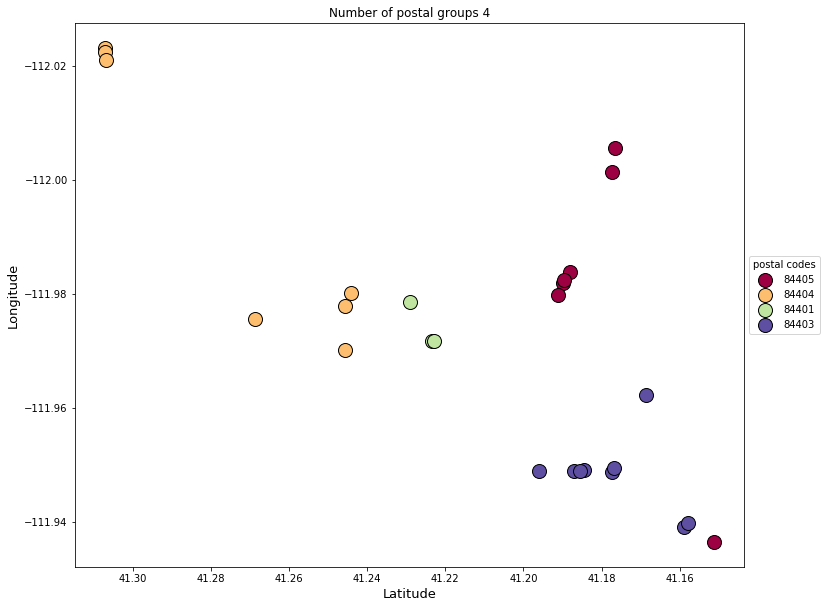

In [24]:
prov_city_groupby = df_fast_clean.groupby(by = ['province','city'])
cp_to_search = ('UT', 'Ogden')

X = prov_city_groupby.get_group(cp_to_search)
X_coords = X[['latitude','longitude']].values
X_labels = X['grp_name'].values
X_postal = X['postalCode']


def postal_show(lat_lon,postal_codes):
    unique_post = set(postal_codes)
    colors = [plt.cm.Spectral(e) for e in np.linspace(0,1,len(unique_post))]

    for k,col in zip(unique_post,colors):
        xy = lat_lon[X_postal.isin([k])]
        plt.plot(xy[:,0],xy[:,1],'o',markerfacecolor=tuple(col),
            markeredgecolor='k', markersize=14)
        plt.ticklabel_format(useOffset=False)

    ax = plt.gca()
    ax.invert_xaxis()
    ax.invert_yaxis()
    ax.set_xlabel('Latitude', fontsize = 13)
    ax.set_ylabel('Longitude',fontsize = 13)

    plt.legend(list(unique_post),loc='center left', bbox_to_anchor=(1, 0.5),title ='postal codes')
    plt.title('Number of postal groups %d' % len(unique_post))
    plt.rcParams["figure.figsize"] = [12,7]
    plt.show()
    
    return



postal_show(X_coords,X_postal)
    

The city of Ogden has 26 restaurants along with 4 postal codes. From the figure above which plots each restaurant by coordinate and groups them via postal codes, we notice two problems that arise from clustering this way. Firstly, restaurants at either end of a postal code are grouped together, as seen by postal code 84404 (yellow). Secondly, a restaurant may be classified with one zip code despite being on the edge of another - this is seen with the bottom right point (84405). 

## <a name="clust-db"></a> Group by DBSCAN:
Perhaps a better way of grouping restaurants would be to use a hierarchical clustering. Here we'll implement a DBSCAN from sklearn's module.

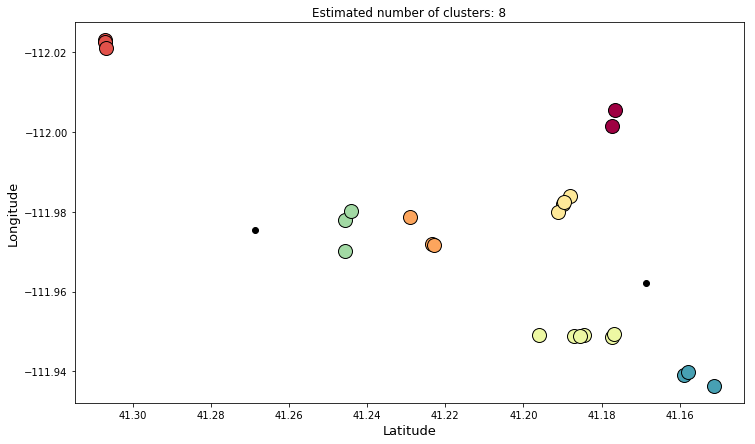

In [16]:
def cluster_show(lat_lon,cluster_fitted):
    
    labels = cluster_fitted.labels_
    core_samples = np.in1d(labels,-1,invert=True)
    n_clusters = len(set(labels).difference([-1]))
    
    unique_labels = set(labels)
    colors = [plt.cm.Spectral(e) for e in np.linspace(0,1,len(unique_labels))]
    
    for k,col in zip(unique_labels,colors):
        if k== -1:
            col = [0,0,0,1] #black
            
        class_member = (labels ==k)
        xy = lat_lon[class_member &core_samples]
        plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)
        plt.ticklabel_format(useOffset=False)

        xy = lat_lon[class_member & ~core_samples]
        plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=6)
        plt.ticklabel_format(useOffset=False)
    
    ax = plt.gca()
    ax.invert_xaxis()
    ax.invert_yaxis()
    ax.set_xlabel('Latitude', fontsize = 13)
    ax.set_ylabel('Longitude',fontsize = 13)
    
    plt.title('Estimated number of clusters: %d' % len(unique_labels))
    plt.rcParams["figure.figsize"] = [12,7]
    plt.show()

    return

#Distance matrix
X_distmtx = Zipcode_Search.haversine_dist(X_coords[:,0][:,None],X_coords[:,1][:,None],
                                          X_coords[:,0],X_coords[:,1])

#eps set to 0.7 miles and minimum number of clusters set to 2
db = DBSCAN(eps=0.7, min_samples=2, metric="precomputed").fit(X_distmtx)
cluster_show(X_coords,db)

A total of 8 clusters are created with two outliers. We can immediately see the two issues we faced via postal code clustering have been alleviated. Going forward, we'll implement this technique to all states and cities. 

### Applying Cluster
We'll apply DBSCAN clustering to group restaurants together within cities and states.

In [17]:
def distance_summary(df_labels, lat_lon,cluster):
    lat_lon = np.asarray(lat_lon)
    df_labels = np.asarray(df_labels)
    
    if lat_lon.ndim == 1: #ignore cities with only one restaurant
        pass
    else:
        
        lat = lat_lon[:,0]
        lon = lat_lon[:,1]
        
        h_mtx = Zipcode_Search.haversine_dist(lat[:,None],lon[:,None],lat,lon)
        cluster = cluster.fit(h_mtx)
        labels = cluster.labels_
        unique_labels_exo = set(labels).difference([-1]) #exclude outliers 
        
        df_c_dist = pd.DataFrame(columns = ['distance','idx1','idx2'])
        
        for l in unique_labels_exo:
            idx = np.where(np.in1d(labels,l))[0]
            
            i = np.where(~np.eye(lat[idx].shape[0],dtype=bool))
            
            lat_c = lat[idx]
            lon_c = lon[idx]
            
            c_dist = Zipcode_Search.haversine_dist(lat_c[i[0]],lon_c[i[0]],lat_c[i[1]],lon_c[i[1]])
            c_label_1 = df_labels[idx][i[0]]
            c_label_2 = df_labels[idx][i[1]]
            results = np.c_[c_dist,c_label_1,c_label_2]
            
            df_c_dist = df_c_dist.append(pd.DataFrame(results,
                                            columns = ['distance','idx1','idx2']),
                                            ignore_index=True)
    
        df_c_dist['distance'] = df_c_dist['distance'].astype(float)
        return df_c_dist.groupby(['idx1','idx2'])['distance'].agg(['mean'])
 
cluster = DBSCAN(eps=0.7, min_samples=2, metric="precomputed")           
restaurant_dist = prov_city_groupby.apply(lambda x:distance_summary(x['grp_name'],x[['latitude','longitude']],cluster))

pd.set_option('display.max_rows', 10)
restaurant_dist

mean
province city         idx1          idx2                    
AK       Fairbanks    dominos pizza other           0.000000
                      other         dominos pizza   0.000000
AL       Anniston     burger king   taco bell       0.300397
                      taco bell     burger king     0.300397
         Atmore       arbys         mc donalds      0.010166
...                                                      ...
WY       Rock Springs taco bell     sonic drive in  0.081109
         Sheridan     other         subway          0.465555
                      subway        other           0.465555
         Wheatland    burger king   other           0.214915
                      other         burger king     0.214915

[7677 rows x 1 columns]

The output above shows the distance between restaurant within cities and provinces.

# <a name="dist-an"></a>Distance Analysis 
Now that we have the distance between restaurants split by province and city, we can take a look at the data from the top-level. 

## <a name="agg-res"></a> Aggregate level analysis



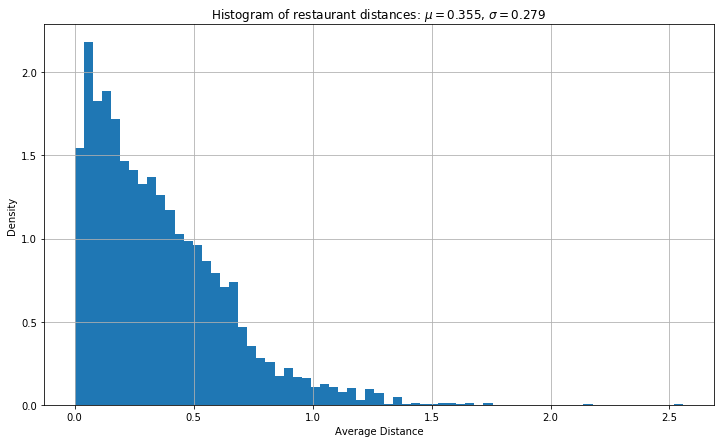

In [18]:
restaurant_dist.hist(bins='fd',normed=True)
m = float(restaurant_dist.mean().round(3))
sd= float(restaurant_dist.std().round(3))
plt.xlabel('Average Distance')
plt.ylabel('Density')
plt.title(r'Histogram of restaurant distances: $\mu=%s$, $\sigma=%s$'%(m,sd))
plt.show()


The average distance amongst all restaurants in the US is approximately 0.36 miles. We can see from our histogram that our data is positively skewed.

In [19]:
#Re-using state polygons downloaded earlier
#Convert to geojson for folium map
shape_geojson = []
for k,s in us_polygons.iteritems():
       geom = s[0].__geo_interface__
       shape_geojson.append(dict(type="Feature",geometry=geom, properties={"name":k}))
       
us_states = dumps({"type": "FeatureCollection","features": shape_geojson}, indent=2)


In [20]:
def create_state_map(df,geo_json):
    mmap=folium.Map(location=[48, -102], zoom_start=3)
    mmap.choropleth(
        geo_data=us_states, 
        data = df.reset_index(),
        columns =['province','mean'],
        key_on = 'feature.properties.name',
        fill_color='Reds',
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name='Average distance(miles)'
    )
    return mmap


dist_overall_state = restaurant_dist.groupby('province').agg('mean')
state_map = create_state_map(dist_overall_state,us_states)

display(state_map)
#To avoid chrome render problems, save as html and open seperately 
state_map.save('state_map.html')


South Dakota, District of Columbia and Hawaii are the states with the largest distances between restaurants, ranging from 0.5 to 0.8 miles.

## <a name="res-res"></a> Restaurant level analysis
We can explore any of the top 10 restaurants specified earlier, let's have a look at Mc donald's

### Mc Donald's analysis

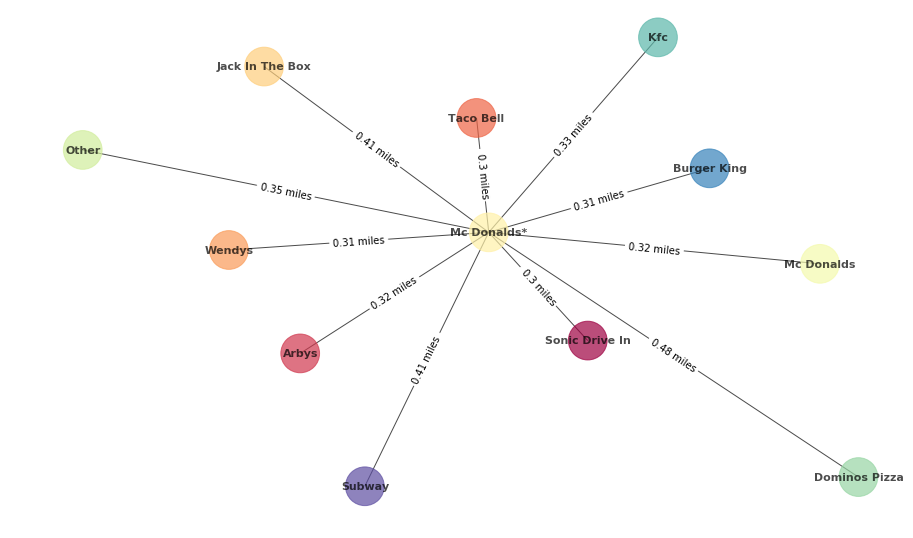

In [21]:
def network_map(focus_n,groups):
    group = groups.xs(focus_n,level = 'idx1')

    labels = group.index.str.title()
    f = [labels[np.where(group.index == focus_n)[0][0]]+'*']*len(group)
    m = (group.round(2).astype(str) +' miles').values
    t = labels
    w = group.rank(ascending = False).values.ravel()
    
    df_input = pd.DataFrame(np.c_[f,t,w,m], columns= ['from','to','weight','mean'])
    
    G = nx.from_pandas_edgelist(df_input, 'from', 'to',['weight','mean'])
    pos = nx.spring_layout(G,k=0.8,iterations=20,scale=2)
    node_colors = [plt.cm.Spectral(e) for e in np.linspace(0,1,len(labels)+1)]
    edge_labels = nx.get_edge_attributes(G,'mean')
    nx.draw(G,pos,with_labels = True,node_size = 1500,
                   node_color = node_colors, node_shape = "o",
                   font_color='k',font_weight="bold",
                   font_size = 11,alpha=0.7)
    
    
    nx.draw_networkx_edge_labels(G,pos,edge_labels = edge_labels,font_size =10,label_pos =0.5)
    plt.rcParams["figure.figsize"] = [12,10]
    plt.show()
    return 

between_res = restaurant_dist.groupby(by=['idx1','idx2']).mean()
network_map('mc donalds',between_res)

The network map above shows the average distance in miles between restaurants across all states and cities. For the most part, the average distance amongst other restaurants ranges from 0.3 to 0.5 miles. The closest restaurant to Mc Donalds is Taco bell, whilst the furthest restaurant is Dominos Pizza. Interestingly, the distance amongst Mc Donalds is one of the largest, let's take a look at box plot for more insight.

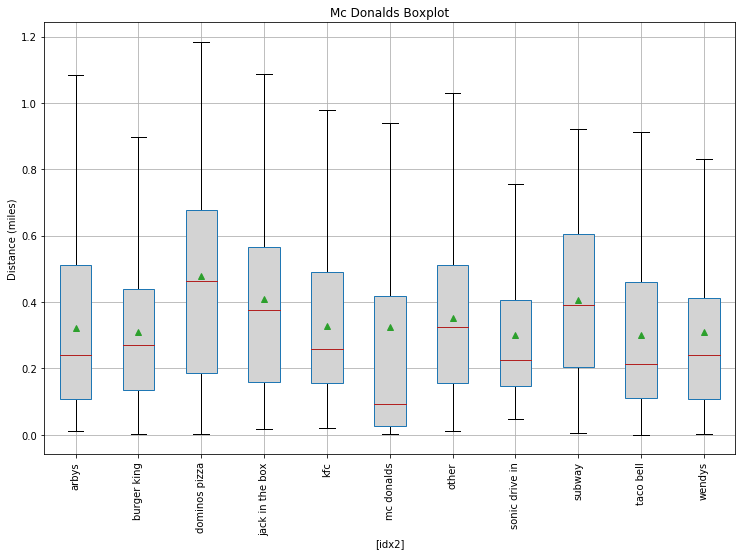

In [22]:
def box_p_create(n1,groups,n2=None,showfliers=False):
    group = groups.xs(n1,level = 'idx1')
    
    if n2 == None:
        title = n1.title() +' Boxplot'
    else:
        group = group.groupby('idx2').get_group(n2)
        title = n1.title() + ' vs '+ n2.title()+', distance (miles)'
    
    #rename group column
    box_p = group.boxplot(by='idx2',showfliers = showfliers,
                  rot=90,figsize=(12,8),patch_artist=True,return_type='both',showmeans=True)
    
    #Styles
    for patch in box_p[0][1]['boxes']:
        patch.set_facecolor('lightgrey')
    
    for patch in box_p[0][1]['medians']:
        patch.set(color='firebrick')
        
    for patch in box_p[0][1]['whiskers']:
        patch.set(color='black')
        
    for patch in box_p[0][1]['means']:
        patch.set(color='black')
    
    
    plt.title(title) 
    plt.suptitle('')
    plt.gca().set_ylabel('Distance (miles)')
    
    return 

box_p_create(n1='mc donalds',groups=restaurant_dist)


The set of box plots above shows Mc donald's distances against all other restaurants, including itself. Focusing solely on Mc Donald's vs Mc Donald's box plot, 50% of distances are between 0.05-0.70 miles.

In [23]:
dist_by_state = restaurant_dist.groupby(['province','idx1','idx2']).agg('mean')
dist_mc_by_state = dist_by_state.xs(('mc donalds','mc donalds'),level=('idx1','idx2'))

mc_map = folium.Map(location=[48, -102], zoom_start=3)
mc_map.choropleth(
    geo_data=us_states, 
    data = dist_mc_by_state.reset_index(),
    columns =['province','mean'],
    key_on = 'feature.properties.name',
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Average distance(miles)'
    )

display(mc_map)

#To avoid chrome render problem
mc_map.save('mc_map.html')

display(dist_mc_by_state.sort_values(by='mean',ascending=False))

,mean
province,
TX,1.742123
IN,1.191704
MO,0.707370
CT,0.703341
SD,0.700731
...,...
GA,0.044247
AZ,0.024850
IA,0.015180


Texas, Indiana and Montana are the three states with the largest distances amongst Mc Donald chains. 